# IPython notebook features overview

IPython allows to create a formatted document containing text, equations, and code. There is a WYSIWYG interface: the ipython notebook.

The document is split into cells. Cells can be of three types:

* Code
* Markdown (simple wiki markup language)
* Raw

This current cell is a markdown cell.

It is possible to use **bold**, *itallic*, and `verbatim`.

    This is some verbatim code.
    $ echo "helloworld"

In addition, it is possible, through python, to add all sorts of contents (html, video, audio, ...) to the page. This notebook aims at demonstrating these possibilities through a number of practical examples.

## Numerical cells and plots

Just like ipython, ipython notebook let's you import easily all the numpy and matplotlib libraries and use them 'matlab' style.

In [1]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


The `inline` option let's you plot things in the notebook directly.

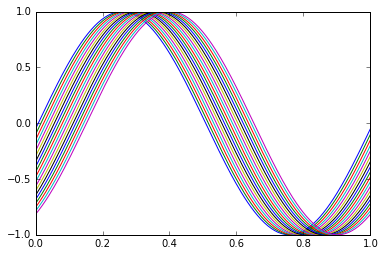

In [2]:
t = linspace(0,1,200)
for i in range(1,20):
    plot(t, sin(2*pi*t-t[10*i]))

It is possible to give this plot **XKCD** style!

/home/gael/anaconda3/lib/python3.5/site-packages/matplotlib/font_manager.py:1288: UserWarning: findfont: Font family ['Humor Sans', 'Comic Sans MS'] not found. Falling back to Bitstream Vera Sans
  (prop.get_family(), self.defaultFamily[fontext]))


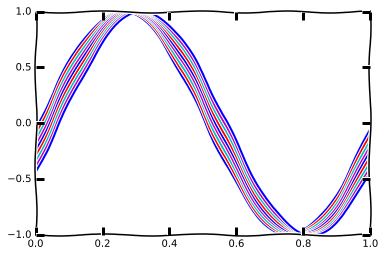

In [3]:
# Running this in a 'with' allows the style to be temporary
with xkcd():
    for i in range(1,10):
        plot(t, sin(2*pi*t-t[10*i]))

## Built-in help

In case you need to be reminded of some syntax, several ways are possible. The first is auto-completion:

In [4]:
# t = lins

It is also possible to display the docstring of a function.

In [5]:
linspace?

The following let's you get even more information and look a the source code.

In [6]:
linspace??

## Magic

Many [ipython magics](http://ipython.readthedocs.org/en/stable/interactive/magics.html) can also be used in ipython notebook. They can be listed using the `%lsmagic` magic.

In [7]:
%lsmagic

Available line magics:
%alias  %alias_magic  %autocall  %automagic  %autosave  %bookmark  %cat  %cd  %clear  %colors  %config  %connect_info  %cp  %debug  %dhist  %dirs  %doctest_mode  %ed  %edit  %env  %gui  %hist  %history  %install_default_config  %install_ext  %install_profiles  %killbgscripts  %ldir  %less  %lf  %lk  %ll  %load  %load_ext  %loadpy  %logoff  %logon  %logstart  %logstate  %logstop  %ls  %lsmagic  %lx  %macro  %magic  %man  %matplotlib  %mkdir  %more  %mv  %notebook  %page  %pastebin  %pdb  %pdef  %pdoc  %pfile  %pinfo  %pinfo2  %popd  %pprint  %precision  %profile  %prun  %psearch  %psource  %pushd  %pwd  %pycat  %pylab  %qtconsole  %quickref  %recall  %rehashx  %reload_ext  %rep  %rerun  %reset  %reset_selective  %rm  %rmdir  %run  %save  %sc  %set_env  %store  %sx  %system  %tb  %time  %timeit  %unalias  %unload_ext  %who  %who_ls  %whos  %xdel  %xmode

Available cell magics:
%%!  %%HTML  %%SVG  %%bash  %%capture  %%debug  %%file  %%html  %%javascript  %%latex  %%

One can for example use the `%timeit` magic to compare the runtime of two pieces of code. For example, let's compare a pure python recursive implementation of the factorial to an implementation using numpy vector routines.

In [8]:
# recursive implementation
def factorial_1(n):
    if n > 1:
        return n*factorial_1(n-1)
    else:
        return 1
    
# numpy implementation
def factorial_2(n):
    return np.prod(np.arange(1,n+1))

In [9]:
%timeit factorial_1(100)

100000 loops, best of 3: 14.8 µs per loop


In [10]:
%timeit factorial_2(100)

The slowest run took 27.85 times longer than the fastest. This could mean that an intermediate result is being cached.
100000 loops, best of 3: 2.39 µs per loop


## Equations

IPython notebooks allow to display equations just by typing in latex. For example, we can write the famous Fourier transform equation as
$$
\int_{-\infty}^\infty f(t) e^{-i\omega t} dt.
$$

It is also possible to add some math in text, for example  a linear system $Ax = b$.

## Images

It is possible to include images in the notebooks, either by adding the html tags directly in markdown cell such as the following:

<img src="http://mediacom.epfl.ch/files/content/sites/mediacom/files/EPFL-Logo.jpg" width=400>

or by using an ipython widget.

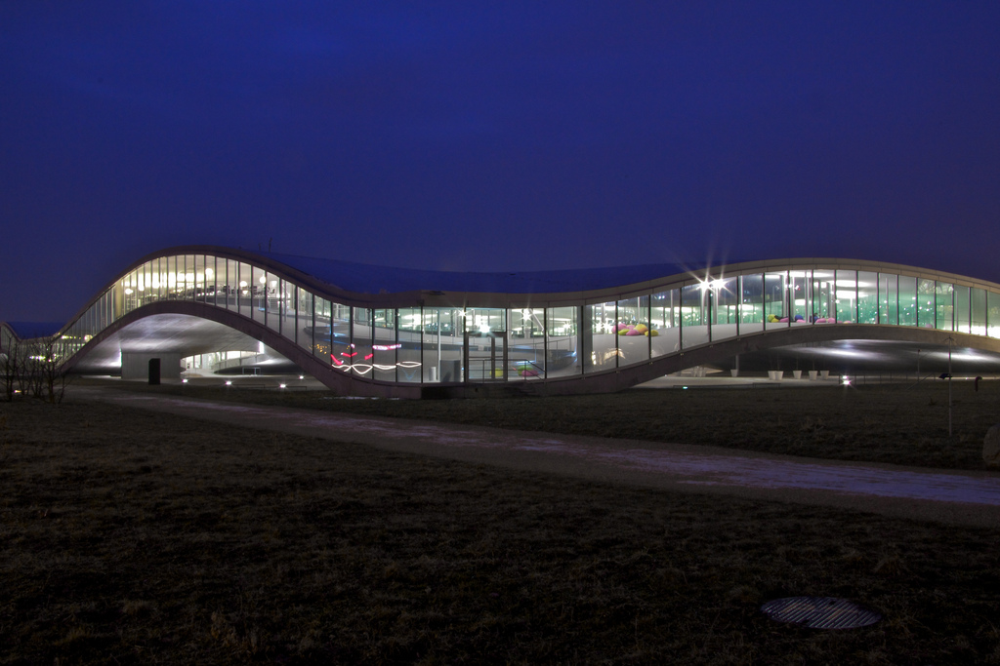

In [11]:
from IPython.display import Image
# Photos credit: https://commons.wikimedia.org/wiki/File:Rolex_Learning_center.jpg
Image('./Data/rlc.jpg', width=800,height=600)

## Videos

Videos can be embedded in the notebook. For example, here is a youtube video.

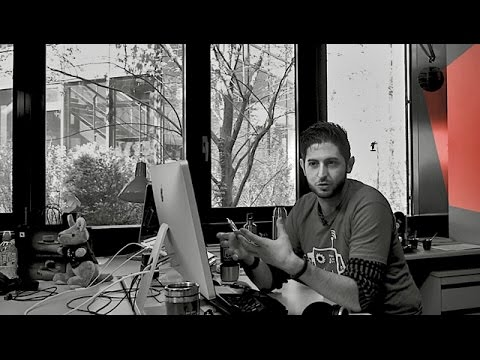

In [12]:
from IPython.display import YouTubeVideo
from datetime import timedelta

# It is possible to start the video at a specific time
start=int(timedelta(hours=0, minutes=1, seconds=45).total_seconds())

YouTubeVideo("uiliyEYy1S4", start=start, autoplay=0, theme="light", color="red")

And here is a vimeo video.

In [13]:
from IPython.display import VimeoVideo

VimeoVideo("70371614")

In [14]:
from IPython.display import IFrame

IFrame('http://ada.epfl.ch', width=800, height=600)

## Audio data

IPython notebook also makes it possible to listen to audio data in the browser directly. To demonstrate this, we will convolve some speech with a [room impulse response](http://nbviewer.ipython.org/github/LCAV/SignalsOfTheDay/blob/master/Room_Acoustics/Room%20Impulse%20Response.ipynb). Then we will process the room impulse response to give the illusion of a larger room.

In [15]:
from scipy.io import loadmat, wavfile
from IPython.lib.display import Audio

# import the speech from a wav file
r,speech = wavfile.read('Data/german_speech_44100.wav')
_,rir = wavfile.read('Data/RIRs.wav')

# Add the audio widget
print('Speech')
display(Audio(data=speech, rate=r))
print('Room Impulse Response')
display(Audio(data=rir[:,0], rate=r))

Speech


Room Impulse Response


## Interactive Widgets

The impulse responses were actually recorded with an eight microphone array.

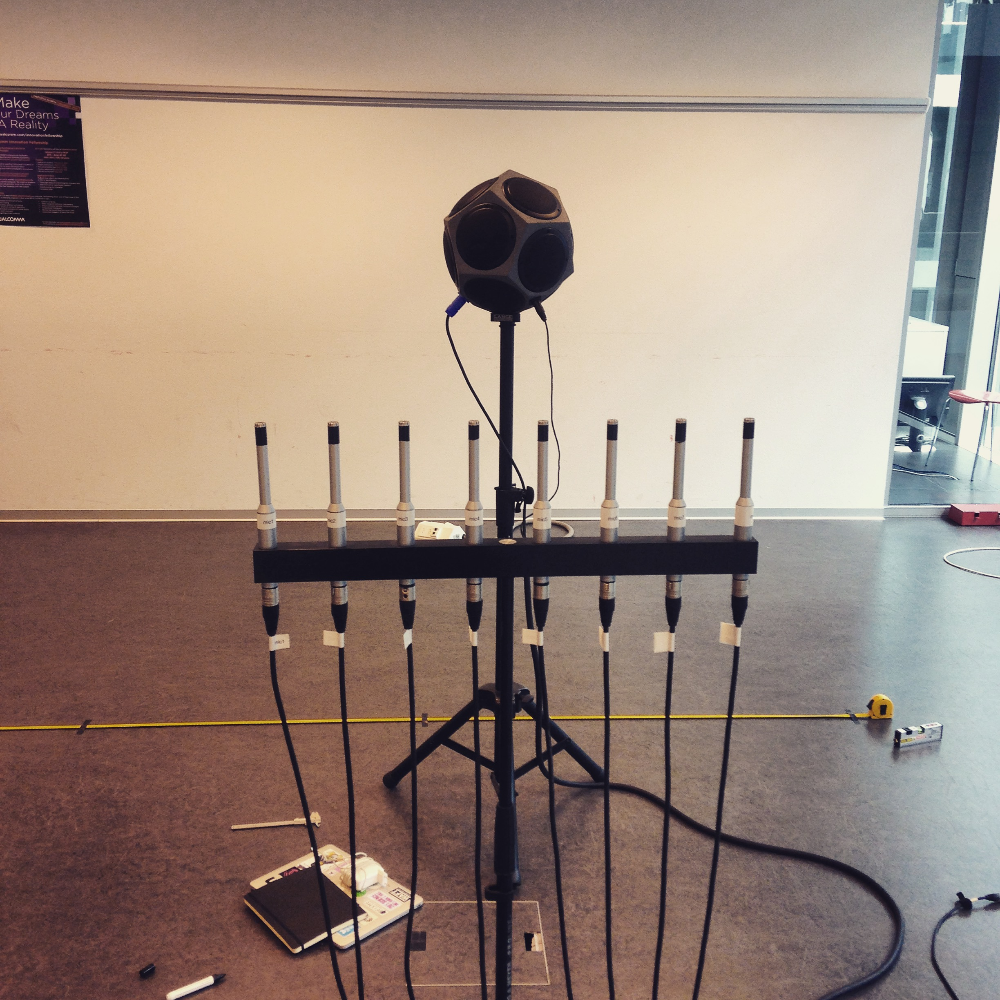

In [16]:
Image('Data/mic_array.jpg', width=200, height=200)

IPython also allows to create interactive widgets to easily visualize graphs with varying parameters. Let us use that to look at the room impulse response for the different microphones. Unfortunately, the widgets are not preserved when you export to html. 

<function __main__.plot_rir>

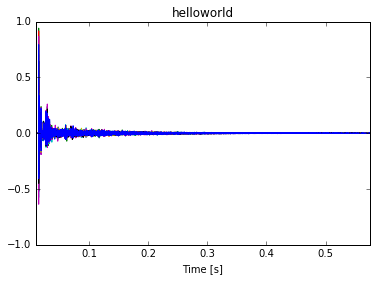

In [17]:
from IPython.html.widgets import interact, fixed

# We need to define a function that takes as arguments the parameters
# we would like to play with.
def plot_rir(s=None, length=30000, number=8, offset=False, text='helloworld'):
    if s is None:
        return
    
    if offset:
        n = 0.2
    else:
        n = 0.    
        
    plot(np.arange(500,500+length)/float(r), s[500:500+length,number-1::-1]+n*np.arange(number), linewidth=1)
    title(text)
    xlim((400./r,(400.+length)/r))
    if offset:
        ylim((-1,2.5))
    else:
        ylim((-1,1))    
    xlabel('Time [s]')

# Now we only need to call the interact function
# keyword arguments are used to give the parameter ranges
interact(plot_rir, s=fixed(rir), length=(500, 25000, 1000), number=(1,8), text=['helloworld','room impulse responses'])

The cool thing is that we are not limited to use this with plots. Let us see what happens when we stretch the room impulse response and convolve the speech with it.

Start at `stretch = 0` for anechoic speech and increase the stech factor. Notice how the room gets bigger!

In [18]:
from scipy.signal import resample, fftconvolve

def listen_rir(rir=None, speech=None, stretch=0):
    
    if rir is None or speech is None:
        return
    
    if stretch == 0:
        s = speech
    else:
        h = resample(rir, rir.shape[0]*stretch)
        s = fftconvolve(speech, h)
        
    display(Audio(data=s, rate=r))
    
v = interact(listen_rir, rir=fixed(rir[:,0]), speech=fixed(speech), stretch=(0,10))
display(v)

<function __main__.listen_rir>

## Interactive plots with Bokeh

Until now, all the plots we have shown were not interactive, that is, it was not possible to zoom into some part of the graph or moves things around. [Bokeh](http://bokeh.pydata.org) is a python module that allows just to do that. In style!

In [19]:
from bokeh.plotting import figure, show, output_notebook
output_notebook()

Loading BokehJS ...

In [20]:
N = 1000

x = np.linspace(-10, 10, N)
y = np.linspace(-10, 10, N)
xx, yy = np.meshgrid(x, y)
d = np.sin(xx)*np.cos(yy)
d = (xx**2 + yy**2)**0.7 - 4.*np.sin(2*xx) - 1.8*np.cos(2*yy)

p = figure(x_range=[-10, 10], y_range=[-10, 10])
p.image(image=[d], x=[-10], y=[-10], dw=[20], dh=[20], palette="Spectral11")

show(p)

## Magnificient plots with Seaborn

[Seaborn](http://stanford.edu/~mwaskom/software/seaborn/index.html) is a python package that wraps around matplotlib and make the plots look extremely nice. It adds nice default colormaps and has integrated options for fancy plots.

It is not installed by default with anaconda so to obtain type the following in a terminal

    conda install seaborn
    
or install it from the Navigator app (as shown during the lab session).
    
To demonstrate it, we have collected tweets containing the following keywords:

* reproducible research
* ipython notebook
* open access
* open science
* open data
* bigdata
* epfl

This example was mostly taken from this [tutorial](http://adilmoujahid.com/posts/2014/07/twitter-analytics/).

To activate seaborn, simply import it. It is possible to set a default palette.

In [21]:
import seaborn as sns

# set the default color palette
# try other options: 'Blues', sns.cubehelix_palette(8)
sns.set_palette('Blues')

# Seaborn can also use a context for different purpose
# possible values are paper, notebook, talk, and poster
sns.set_context("notebook")

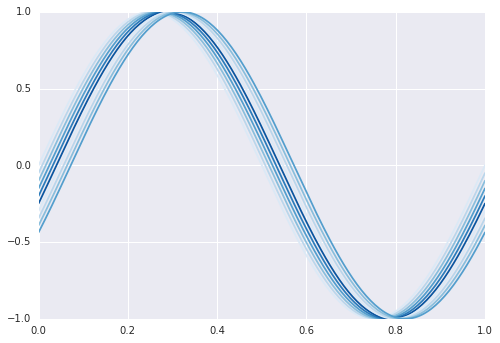

In [22]:
# try to plot our boring old sine curves
for i in range(0,10):
    plot(t, sin(2*pi*t-t[10*i]))

Now we will import the tweets in a [pandas](http://pandas.pydata.org) to do some statistics.

In [23]:
import json
import pandas as pd

In [24]:
tweets_data_path = './Data/twitter_data.txt'

tweets_data = []
tweets_file = open(tweets_data_path, "r")
for line in tweets_file:
    try:
        tweet = json.loads(line)
        tweets_data.append(tweet)
    except:
        continue
        
tweets = pd.DataFrame()

fields = ['text','lang']
for f in fields:
    tweets[f] = list(map(lambda tweet: tweet[f], tweets_data))

tweets['country'] = list(map(lambda tweet: tweet['place']['country'] if tweet['place'] != None else None, tweets_data))
tweets['username'] = list(map(lambda tweet: tweet['user']['screen_name'], tweets_data))
tweets['followers_count'] = list(map(lambda tweet: tweet['user']['followers_count'], tweets_data))
tweets['time_zone'] = list(map(lambda tweet: tweet['user']['time_zone'], tweets_data))

tweets['text_len'] = list(map(lambda tweet: len(tweet), tweets['text']))

print('We got',len(tweets_data),'tweets.')

We got 10698 tweets.


Now we want to analyze words appearing in the tweets. We will apply a regular expression to detection keywords in the text of tweets. Then we plot a histogram of the data to see which keywords are popular.

In [25]:
import re

In [26]:
# a helper function to apply the regexp
def word_in_text(words, text):
    words = re.sub('\s+','\s*', ''.join([w + '|' for w in words[:-1]]) + words[-1])
    text = text.lower()
    match = re.search(words, text)
    if match:
        return True
    return False

In [27]:
# actually apply the regexp
keywords = ['open access', 'open science', 'ipython', 'open data', 'reproducible research','epfl']
for w in keywords:
    tweets[w] = tweets['text'].apply(lambda tweet: word_in_text([w], tweet))
    
tweets_by_kw = pd.Series([tweets[w].value_counts()[True] for w in keywords], index=keywords)

Seaborn has specialized routine to plot dataframes from pandas. We make use of that to plot the histogram.

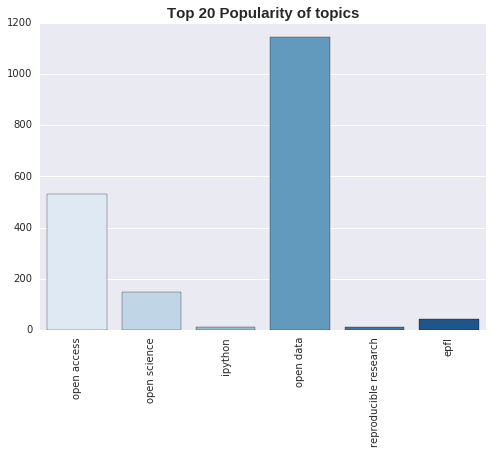

In [28]:
def nice_bar_plot(xlbl, data, n):
    
    fig, ax = plt.subplots()
    ax.set_title('Top ' + str(n) + ' ' + xlbl, fontsize=15, fontweight='bold')
    sns.barplot(data[:n].keys(), data[:n], ax=ax)
    locs, labels = plt.xticks()
    plt.setp(labels, rotation=90)
    
nice_bar_plot('Popularity of topics', tweets_by_kw, 20)

We would like to get some idea of the distribution of the length of the tweets in each of these category. Let us categorize each tweet and then display some boxplot. Again, seaborn allows to do that fairly easily.

In [29]:
# Here we want to tag each tweet with a category
tweets['category'] = np.nan
for kw in keywords:
    tweets.loc[tweets[kw] == True,'category'] = kw

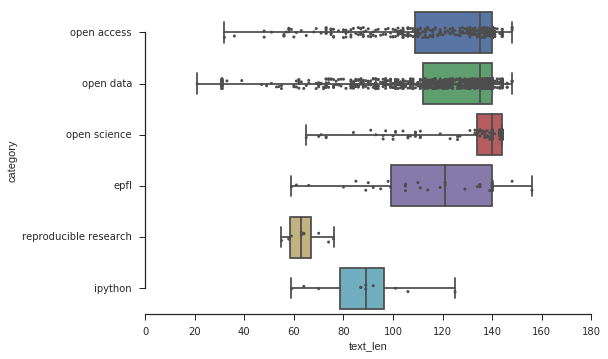

In [30]:
sns.set(style="ticks", color_codes=True)

# Plot the text length with horizontal boxes
ax = sns.boxplot(x="text_len", y="category", data=tweets,
                 whis=np.inf)

# Add in points to show each tweet
sns.stripplot(x="text_len", y="category", data=tweets,
              jitter=True, size=3, color=".3", linewidth=0)


# This removes top and right axis
sns.despine(trim=True)

## Conclusion

IPython offers great tools both for computional experiments and to share these experiments in a visually enticing way.

The notebook format can be shared as is to allow someone else to play with the data, or it can be converted to format that allow for displaying such as html, latex, pdf, etc. To do so, use the `ipython nbconvert` utility in the terminal.